## This note book takes the output of QC file generated from 2_1 and performs confident barcode calling pipeline

## Debarcoding, classifier, and QC

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path
import numpy as np
import os
import sys
import glob
import pandas as pd
import xml.etree.ElementTree as et
import datetime
from imageio import volread as imread

import tifffile

# from pystackreg import StackReg --> don't run this, run this with imlab environment
from skimage.filters import threshold_otsu

import seaborn as sns
#from pystackreg.util import to_uint16

from skimage import measure
from scipy import stats
import umap
import scanpy as sc
import math
#from umap.umap_ import UMAP
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import pickle

In [2]:
os.getcwd()

'/Volumes/imagestore/Brian/Kang_et_al_2024_Codes'

In [3]:
# locate to correct data folder
# data dirs
# 101222_D10_Coverslip1_Processed
# 102022_D10_Coverslip2_Reimage_Processed
# 101422_D10_Coverslip3_Processed
# 102222_D10_Coverslip4_Reimage_Processed
# 101922_D10_Coverslip5_Processed
DATA_DIR = '101222_D10_Coverslip1_Processed'
SEG_DIR = 'Cellpose_Segmentation_masks'
MP_DIR = 'mp_score_max'
CP_DIR = 'cp_output_cellpose'
META_DIR = 'metadata'
Compartment = 'Soma'
SAMPLE = 'Coverslip1'

# change directory
os.chdir(f'../{DATA_DIR}')
print(os.getcwd())
_allFOVs = sorted(glob.glob(f'{MP_DIR}/*'))
allFOVs = [x.split('F')[-1][:3] for x in _allFOVs]
len(allFOVs)

/Volumes/imagestore/Brian/101222_D10_Coverslip1_Processed


225

,channel_number,cycle_number,marker_name,Filter,excitation_wavelength,emission_wavelength,Bandwidth,ch_index,Split_Num
0,1,0,DNA_0,DAPI,405,445,46,0,0
1,2,0,Blank_488_0,GFP,488,521,38,1,1
2,3,0,Blank_561_0,RFP,561,594,43,2,2
3,4,0,Blank_637_0,Cy5,637,698,77,3,3
4,5,1,DNA_1,DAPI,405,445,46,0,4
5,6,1,NWS,GFP,488,521,38,1,5
6,7,1,VSVG,RFP,561,594,43,2,6
7,8,1,FLAG,Cy5,637,698,77,3,7
8,9,2,DNA_2,DAPI,405,445,46,0,8
9,10,2,HSV,GFP,488,521,38,1,9


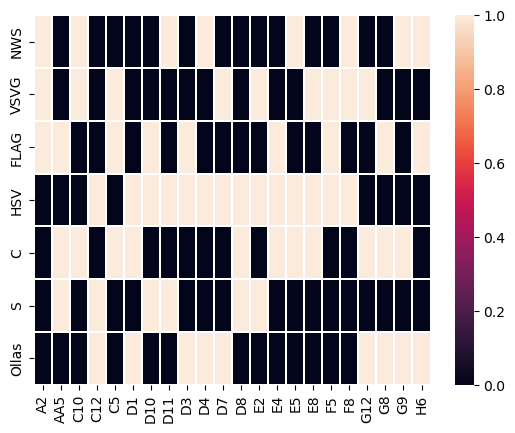

In [5]:
# load metadata - load full codebook as well
full_codebook = pd.read_csv(f'../{META_DIR}/full_codebook.csv',sep=',', index_col=0) # this is "legal" codebook
Procode_gRNA = pd.read_csv(f'../{META_DIR}/PROCODE_gRNA.csv',sep=',')
legal_codes = sorted(list(set(Procode_gRNA['ProCode ID'].to_list())))
codebook = full_codebook[legal_codes]
#AllProcodes = pd.read_csv('AllProcodes.csv', sep='.')
sns.heatmap(codebook, linewidths = 0.3)
markers = pd.read_csv(f'../{META_DIR}/markers.csv')
markers.head(50)

In [6]:
def get_cell_coords(cell_label, coord_data):
    
    x2 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMaximum_X']
    y2 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMaximum_Y']
    x1 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMinimum_X']
    y1 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMinimum_Y']
    
    return round(x1),round(x2),round(y1),round(y2)

def Calculate_PCA_Loadings(X):
    
    pca = PCA(random_state=1)
    PCs = pca.fit_transform(X)
    exp_var_pca = pca.explained_variance_ratio_ # only visualize top 10 PCs
    
    ratio = exp_var_pca[0]/(exp_var_pca[1]+1e-15) # PC1/PC2
    if math.isnan(ratio): 
        ratio = 1
    #
    return exp_var_pca[0], exp_var_pca[1], exp_var_pca[2], ratio # %var of PC1, PC2, PC3, ratio 

## Load from here

In [7]:
# load soma_df
soma_df = pd.read_csv(f'{SAMPLE}_soma_df_CellPose.csv',sep=',')
soma_df

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,PC3_var,PC1/PC2,intensity_mean-0,intensity_mean-1,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta
0,1,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.709899,PGGT1B,...,NaN,1.000000e+00,111.071303,109.450704,108.845070,109.867958,111.278169,114.350352,108.711268,1.203345
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225e+00,386.916210,PGGT1B,...,0.166348,1.209200e+00,166.766355,175.954439,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719e+00,315.950102,PPP2R2B,...,0.092976,1.853801e+00,112.767107,116.505402,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,1.297452e-01,460.463648,PGGT1B,...,0.062753,1.107212e+01,261.031465,232.868240,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782
4,5,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.120506,PGGT1B,...,NaN,1.000000e+00,110.485921,110.711987,109.411907,109.694288,110.930813,111.946903,108.967820,0.226066
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111510,216,intensity_mean-10,0.000099,D7,0.000099,1.000000,25.319791,5.574618e-09,303.575247,MLH1,...,0.000000,1.000000e+15,112.687380,120.663480,110.560229,111.981836,116.680688,117.143403,112.204589,3.993308
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396e+00,496.104350,HRAS,...,0.135329,2.128927e+00,113.079306,127.956629,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,6.179551e-01,371.703301,FAN1,...,0.162668,1.443519e+00,188.278229,112.791328,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479e+00,1578.212837,WASL,...,0.069303,7.131989e+00,109.870510,706.757089,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837


In [8]:
# run UMAP
reducer = umap.UMAP(low_memory=True)
umap_cols = ['intensity_mean-0',
       'intensity_mean-1', 'intensity_mean-2', 'intensity_mean-3',
       'intensity_mean-4', 'intensity_mean-5', 'intensity_mean-6']
umap_df = soma_df[umap_cols]
embedding = reducer.fit_transform(umap_df.values)
print(embedding.shape)

# append embedding to epitope_df and debarcoded_df
soma_df[['embedding1','embedding2']] = embedding
soma_df

(111515, 2)


,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,intensity_mean-0,intensity_mean-1,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,embedding1,embedding2
0,1,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.709899,PGGT1B,...,111.071303,109.450704,108.845070,109.867958,111.278169,114.350352,108.711268,1.203345,13.330976,11.701002
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225e+00,386.916210,PGGT1B,...,166.766355,175.954439,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551,12.619859,2.877971
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719e+00,315.950102,PPP2R2B,...,112.767107,116.505402,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395,13.320225,8.750843
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,1.297452e-01,460.463648,PGGT1B,...,261.031465,232.868240,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782,9.010771,-1.592654
4,5,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.120506,PGGT1B,...,110.485921,110.711987,109.411907,109.694288,110.930813,111.946903,108.967820,0.226066,13.574752,12.039292
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111510,216,intensity_mean-10,0.000099,D7,0.000099,1.000000,25.319791,5.574618e-09,303.575247,MLH1,...,112.687380,120.663480,110.560229,111.981836,116.680688,117.143403,112.204589,3.993308,13.665383,9.866673
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396e+00,496.104350,HRAS,...,113.079306,127.956629,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861,11.083485,-5.031023
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,6.179551e-01,371.703301,FAN1,...,188.278229,112.791328,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505,10.216071,3.802050
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479e+00,1578.212837,WASL,...,109.870510,706.757089,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837,-3.052140,-3.189703


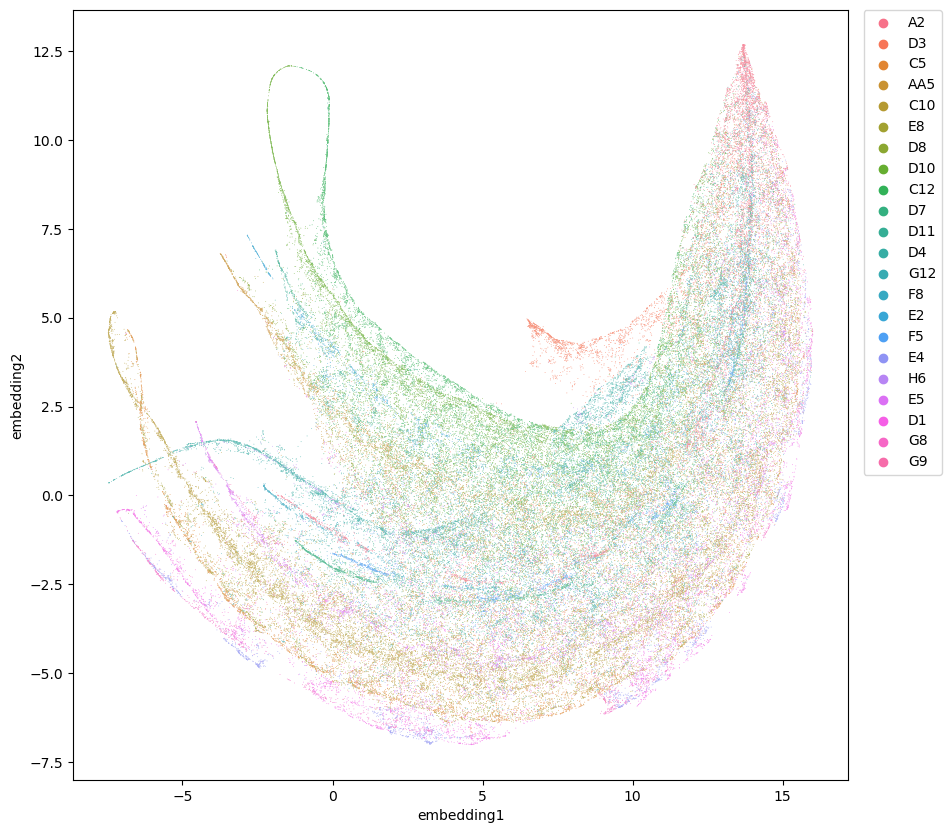

In [9]:
# plot UMAP of ALL images - embedding based on epitope signals
fit, ax = plt.subplots(figsize=(10,10))
sns.scatterplot(data = soma_df, x='embedding1', y='embedding2', hue = 'Barcode', ax=ax, s=0.3)
ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

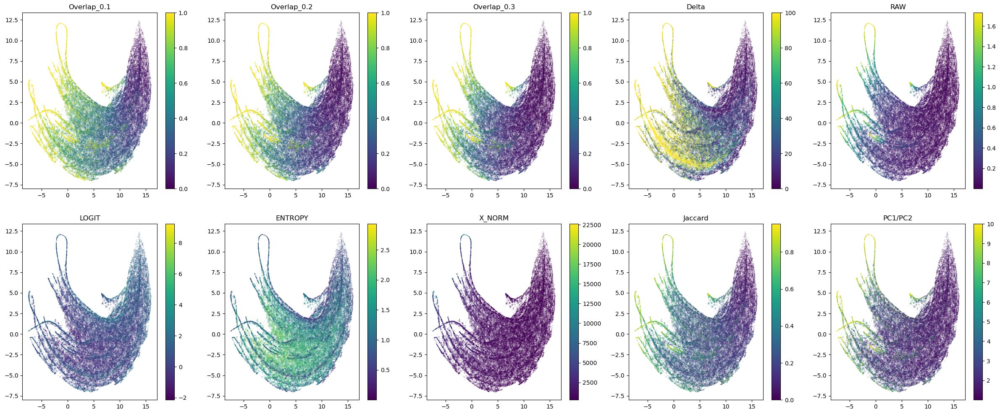

In [10]:
# plot by 0) OverlapScore, 1) P, 2) RAW 3) LOGIT 4) ENTROPY
cols_to_plot = ['Overlap_0.1','Overlap_0.2','Overlap_0.3','Delta','RAW','LOGIT',
                'ENTROPY','X_NORM','Jaccard','PC1/PC2']
fig,axs = plt.subplots(2,5, figsize=(30,12))
axs = axs.ravel()
df = soma_df[~soma_df['LOGIT'].isna()]
##cutoff_logit = np.quantile(df['LOGIT'], 0.99)
#cutoff_raw = np.quantile(df['RAW'], 0.01)
# df_to_plot = df[~(df.RAW < cutoff_raw) & (df.LOGIT < cutoff_logit)]
df_to_plot = df[abs(df.LOGIT) < 10] # after removing outlier 
df_to_plot = df_to_plot[df_to_plot['PC1/PC2'] < 30] # AFTER removing outlier
for i in range(len(cols_to_plot)):
    col = cols_to_plot[i]
    if col == 'Delta':
        plot=axs[i].scatter(df_to_plot.embedding1,df_to_plot.embedding2, c=df_to_plot[col], 
                            vmax= 100, s=0.01)
    elif col == 'PC1/PC2':
        plot =axs[i].scatter(df_to_plot.embedding1,df_to_plot.embedding2, c=df_to_plot[col],
                            vmax=10, s = 0.01)
    else:
        plot=axs[i].scatter(df_to_plot.embedding1,df_to_plot.embedding2, c=df_to_plot[col],s=0.01)
    fig.colorbar(plot, ax=axs[i])
   
    axs[i].set_title(col)

## Check baseline distribution

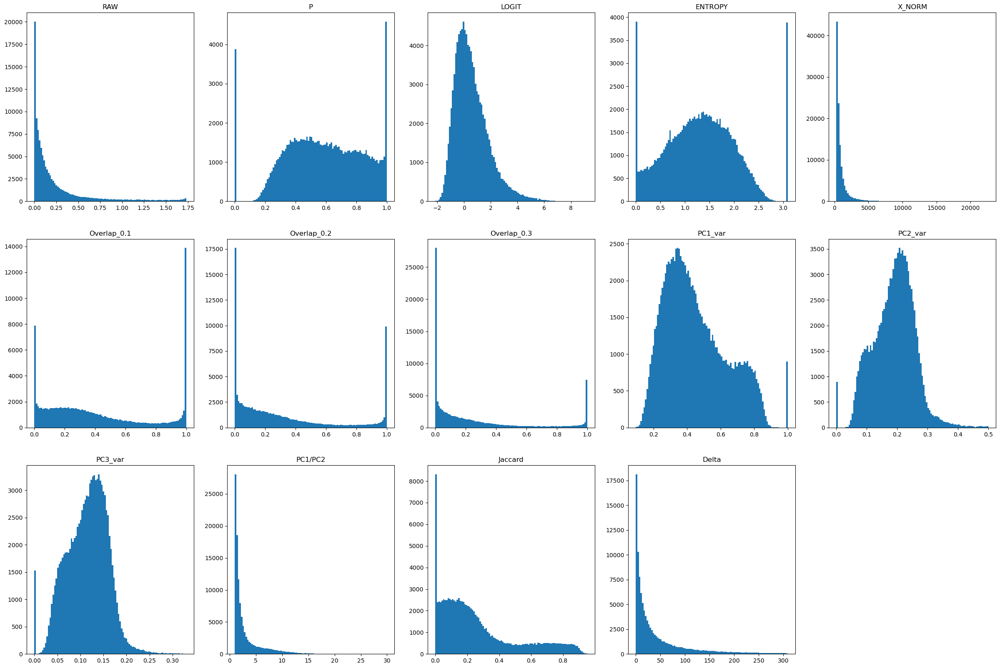

In [11]:
fig,axs = plt.subplots(3,5,figsize=(30,20))
axs=axs.ravel()
cols_to_plot = ['RAW','P','LOGIT','ENTROPY', 'X_NORM', 'Overlap_0.1','Overlap_0.2','Overlap_0.3',
               'PC1_var','PC2_var','PC3_var','PC1/PC2','Jaccard','Delta']
for i in range(len(axs)-1):
    col = cols_to_plot[i]
    if col == 'LOGIT':
        #df = soma_df[~soma_df['LOGIT'].isna()]
        #cutoff = np.quantile(soma_df[col], 0.999)
        
        axs[i].hist(soma_df[abs(soma_df[col])<10][col], bins=100)
        #axs[i].hist(soma_df[col], bins=100)
        axs[i].set_title(col)
    elif col == 'PC1/PC2':
        cutoff = np.quantile(soma_df[col], 0.99)
        axs[i].hist(soma_df[soma_df[col]<30][col], bins = 100)
        #axs[i].hist(soma_df[col], bins = 100)
        axs[i].set_title(col)
    elif col == 'Delta':
        cutoff = np.quantile(soma_df[col], 0.95)
        axs[i].hist(soma_df[soma_df[col]<cutoff][col], bins = 100)
        #axs[i].hist(soma_df[col], bins = 100)
        axs[i].set_title(col)
    else:
        axs[i].hist(soma_df[col], bins = 100)
        axs[i].set_title(col)
fig.delaxes(axs[-1])

Removing 7392 Cells


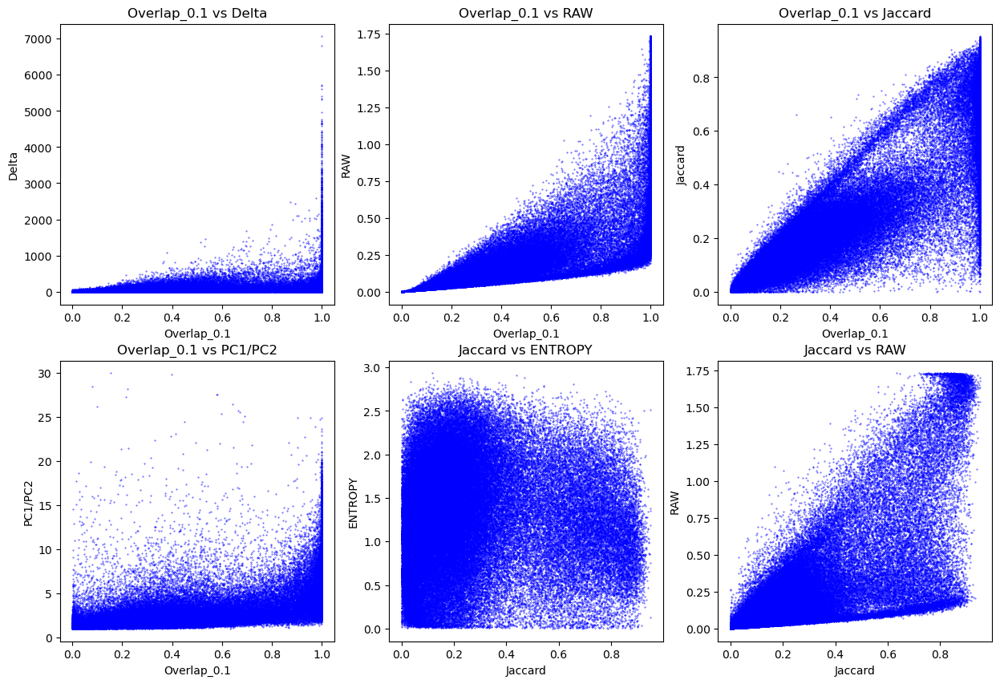

In [12]:
# plot all points
fig, axs = plt.subplots(2,3,figsize=(15,10))
axs = axs.ravel()
col_to_plot = ['Delta','RAW','Jaccard','PC1/PC2']
df_to_plot = soma_df[(abs(soma_df.LOGIT) < 10)&(soma_df['PC1/PC2']<30)]
print(f"Removing {len(soma_df) - len(df_to_plot)} Cells")
col_to_plot2 = ['ENTROPY','RAW']
for i in range(len(axs)):
    if i < 4:
        col = col_to_plot[i]
        df1 = df_to_plot
        axs[i].scatter(df1['Overlap_0.1'], df1[col], s=0.1, color='b')
        axs[i].set_xlabel('Overlap_0.1')
        axs[i].set_ylabel(col)
        axs[i].set_title(f'Overlap_0.1 vs {col}')
    else:
        
        df1 = df_to_plot
        axs[i].scatter(df1['Jaccard'], df1[col_to_plot2[i-4]], s=0.1, color='b')
        axs[i].set_xlabel('Jaccard')
        axs[i].set_ylabel(col_to_plot2[i-4])
        axs[i].set_title(f'Jaccard vs {col_to_plot2[i-4]}')

## load ground truth, build classifier

In [13]:
os.getcwd()

'/Volumes/imagestore/Brian/101222_D10_Coverslip1_Processed'

In [14]:
label_F012_13 = pd.read_csv('./barcode_labels/F012_13_Labels.csv', header=None)
label_F062_63 = pd.read_csv('./barcode_labels/F062_63_Labels.csv', header=None)
label_F112_113 = pd.read_csv('./barcode_labels/F112_113_Labels.csv', header=None)
label_F162_163 = pd.read_csv('./barcode_labels/F162_163_Labels.csv', header=None)
label_F212_213 = pd.read_csv('./barcode_labels/F212_213_Labels.csv', header=None)
labels_dict = {}
labels_dict[13] = label_F012_13
labels_dict[63] = label_F062_63
labels_dict[113] = label_F112_113
labels_dict[163] = label_F162_163
labels_dict[213] = label_F212_213

In [15]:
label_ims = [13, 63, 113, 163, 213]
for num in label_ims:
    print(labels_dict[num].shape, soma_df[soma_df.ImageNumber==num].shape)

(272, 1) (272, 29)
(908, 1) (908, 29)
(452, 1) (452, 29)
(325, 1) (325, 29)
(330, 1) (330, 29)


In [16]:
# create ground truth label in soma_df
soma_df['True_Label'] = 0 # initialize all cells to 0
label_ims = [13, 63, 113, 163, 213]
for im_num in label_ims:
    ind = soma_df[soma_df.ImageNumber==im_num].index
    N_Cells = labels_dict[im_num].shape[0]
    soma_df.loc[ind, 'True_Label'] = labels_dict[im_num].values.reshape((N_Cells,))
soma_df

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,intensity_mean-1,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,embedding1,embedding2,True_Label
0,1,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.709899,PGGT1B,...,109.450704,108.845070,109.867958,111.278169,114.350352,108.711268,1.203345,13.330976,11.701002,0
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225e+00,386.916210,PGGT1B,...,175.954439,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551,12.619859,2.877971,0
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719e+00,315.950102,PPP2R2B,...,116.505402,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395,13.320225,8.750843,0
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,1.297452e-01,460.463648,PGGT1B,...,232.868240,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782,9.010771,-1.592654,0
4,5,intensity_mean-0,0.000000,A2,0.000000,0.000000,-34.538776,3.091042e+00,292.120506,PGGT1B,...,110.711987,109.411907,109.694288,110.930813,111.946903,108.967820,0.226066,13.574752,12.039292,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111510,216,intensity_mean-10,0.000099,D7,0.000099,1.000000,25.319791,5.574618e-09,303.575247,MLH1,...,120.663480,110.560229,111.981836,116.680688,117.143403,112.204589,3.993308,13.665383,9.866673,0
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396e+00,496.104350,HRAS,...,127.956629,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861,11.083485,-5.031023,0
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,6.179551e-01,371.703301,FAN1,...,112.791328,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505,10.216071,3.802050,0
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479e+00,1578.212837,WASL,...,706.757089,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837,-3.052140,-3.189703,0


In [17]:
# sanity check
label_ims = [13, 63, 113, 163, 213]
for num in label_ims:
    N_Cells = labels_dict[num].shape[0]
    print(np.array_equal(soma_df[soma_df.ImageNumber==num].True_Label, labels_dict[num].values.reshape((N_Cells,))))

True
True
True
True
True


In [18]:
print(set(soma_df.True_Label))

{0, 1}


Removing 0 Cells


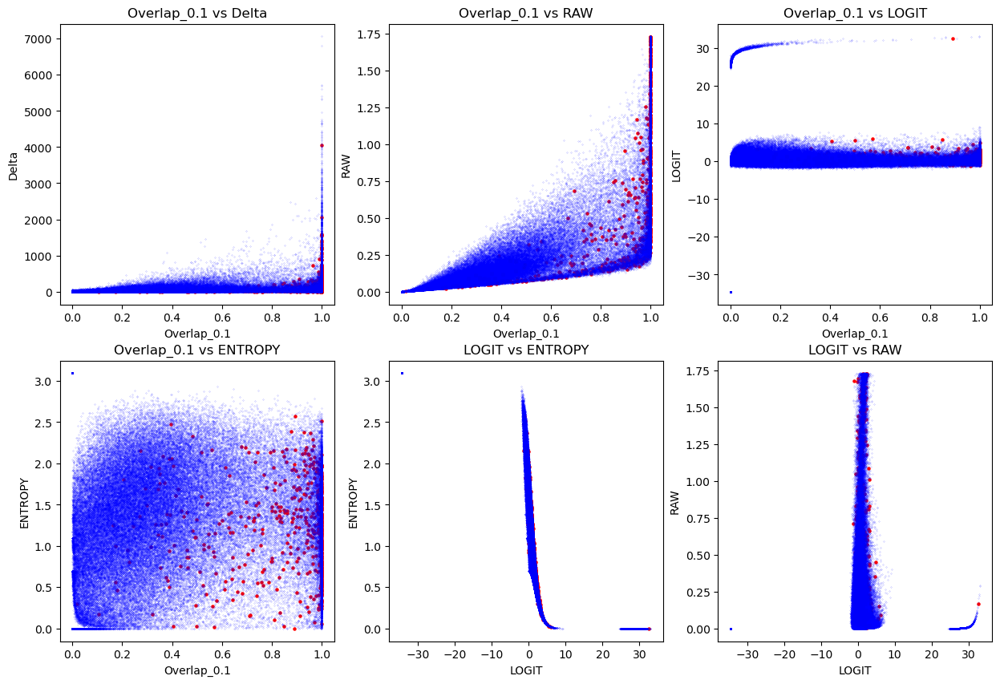

In [19]:
# plot partially labelled 
# scatter plot, same as above, except outlier 94.
# P vs X_NORM, RAW vs X_NORM, LOGIT vs X_NORM, ENTROPY vs X_NORM
fig, axs = plt.subplots(2,3,figsize=(15,10))
axs = axs.ravel()
col_to_plot = ['Delta','RAW','LOGIT','ENTROPY']


#df_to_plot = soma_df[abs(soma_df.LOGIT) < 10]
df_to_plot=soma_df.copy()
print(f"Removing {len(soma_df) - len(df_to_plot)} Cells")

col_to_plot2 = ['ENTROPY','RAW']
for i in range(len(axs)):
    if i < 4:
        col = col_to_plot[i]
        df1 = df_to_plot[df_to_plot['True_Label'] == 1]
        axs[i].scatter(df1['Overlap_0.1'], df1[col], s=5, color='r')
        df2 = df_to_plot[df_to_plot['True_Label'] == 0]
        axs[i].scatter(df2['Overlap_0.1'], df2[col], s=0.01, color='b')
        axs[i].set_xlabel('Overlap_0.1')
        axs[i].set_ylabel(col)
        axs[i].set_title(f'Overlap_0.1 vs {col}')
    else:
        
        df1 = df_to_plot[df_to_plot['True_Label'] == 1]
        axs[i].scatter(df1['LOGIT'], df1[col_to_plot2[i-4]], s=5, color='r')
        df2 = df_to_plot[df_to_plot['True_Label'] == 0]
        axs[i].scatter(df2['LOGIT'], df2[col_to_plot2[i-4]], s=.01, color='b')
        
        #axs[i].scatter(df_to_plot['LOGIT'], df_to_plot[col_to_plot2[i-4]], s=1)
        axs[i].set_xlabel('LOGIT')
        axs[i].set_ylabel(col_to_plot2[i-4])
        axs[i].set_title(f'LOGIT vs {col_to_plot2[i-4]}')

## Make a classifier

In [20]:
# 1) Logistic Regression on barcoded dataframe
# remove outliers
label_ims = [13, 63, 113, 163, 213]
soma_df_train = soma_df[soma_df.ImageNumber.isin(label_ims)]
soma_df_train.shape

# remove outlier from logit side:
soma_df_train_filtered = soma_df_train[(abs(soma_df_train.LOGIT) < 10)]
print("removing ", len(soma_df_train) - len(soma_df_train_filtered))

feature_cols = ["X_NORM","RAW","Overlap_0.1","Overlap_0.2","Overlap_0.3",
                "Delta","Jaccard","PC1/PC2"]

# Define input and output
X = soma_df_train_filtered[feature_cols]
y = soma_df_train_filtered['True_Label']

# Scale features
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler().fit(X)
X_scaled = scaler.transform(X)
X_scaled

removing  127


array([[-0.20148414, -0.43325652, -0.89607668, ...,  0.1371465 ,
        -0.95723367, -0.64734427],
       [-0.61162829, -0.72179148, -1.3375163 , ..., -0.39528064,
        -1.13223299, -0.49680795],
       [ 0.98915508,  1.230758  ,  1.66804821, ...,  0.04203257,
         1.20627619,  1.83212908],
       ...,
       [-0.21314227, -0.37138563, -0.93332498, ..., -0.35610219,
        -0.86401021, -0.50572571],
       [-0.65563792, -0.71713326, -1.31489477, ..., -0.40804862,
        -1.10129781, -0.64866397],
       [-0.45228545, -0.43637384, -0.22828391, ..., -0.3082794 ,
        -0.23365593, -0.49810269]])

In [21]:
# check the balance 
print(soma_df_train_filtered[soma_df_train_filtered.True_Label == 0].shape[0], 
     soma_df_train_filtered[soma_df_train_filtered.True_Label == 1].shape[0])

1575 585


In [22]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y , test_size=0.3, random_state=2)
logreg = LogisticRegression(class_weight='balanced')
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))

from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

Accuracy of logistic regression classifier on test set: 0.90
[[422  48]
 [ 18 160]]


In [23]:
os.getcwd()

'/Volumes/imagestore/Brian/101222_D10_Coverslip1_Processed'

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


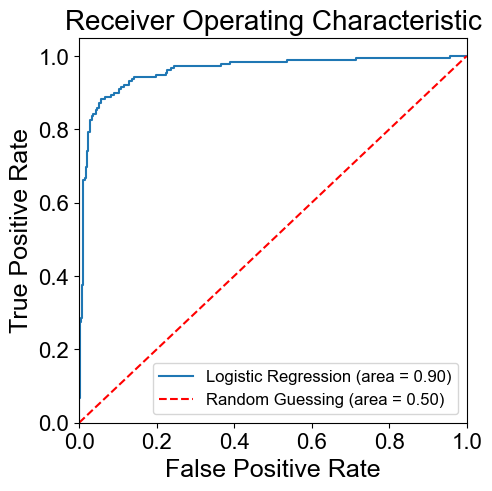

In [30]:
from sklearn.metrics import roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Calculate the ROC AUC score
logit_roc_auc = roc_auc_score(y_test, logreg.predict(X_test))

# Get the false positive rate, true positive rate, and thresholds
fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.rcParams['font.family'] = 'Arial'


# Plot the ROC curve
plt.figure(figsize=(5,5))
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--', label='Random Guessing (area = 0.50)')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=18)
plt.ylabel('True Positive Rate', fontsize=18)
plt.title('Receiver Operating Characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize=16)

# Save the figure as both PNG and EPS
plt.savefig('../Kang_et_al_2024_Codes/Figures/Barcode_QC_Coverslip1_Log_ROC.png')
plt.savefig('../Kang_et_al_2024_Codes/Figures/Barcode_QC_Coverslip1_Log_ROC.eps', format='eps')

plt.show()


Save model for later use - coverslips 2-5 

In [31]:
# save model
with open('../barcoding_logreg_model_CellPose.pkl', 'wb') as f:
    pickle.dump(logreg, f)

In [32]:
with open('barcoding_logreg_model_CellPose.pkl', 'rb') as f:
    logreg_loaded = pickle.load(f)
y_pred = logreg_loaded.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg_loaded.score(X_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.90


## Load Classifier and perform inference to perform single-cell QC 

In [33]:
# load model saved under coverslip1
filename = '../101222_D10_Coverslip1_Processed/barcoding_logreg_model_CellPose.pkl'
best_logreg = pickle.load(open(filename, 'rb'))

# filter out outliers
soma_final = soma_df.copy()
soma_final=soma_final[~soma_final.isna().any(axis=1)]
print(len(soma_df)-len(soma_final))
N=len(soma_final)
soma_final = soma_final[(abs(soma_final.LOGIT)<10) & (soma_final['PC1/PC2'] < 30)]
print(N-len(soma_final))
feature_cols = ["X_NORM","RAW","Overlap_0.1","Overlap_0.2","Overlap_0.3",
                "Delta","Jaccard","PC1/PC2"]
X = soma_final[feature_cols]
# Scale and predict infected cells 
sc = StandardScaler()
X = sc.fit_transform(X)
y_pred = best_logreg.predict(X)
# append the result to InfectedCells
soma_final["InfectedCells"] = y_pred
soma_final

3881
3511


,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,embedding1,embedding2,True_Label,InfectedCells
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225,386.916210,PGGT1B,...,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551,12.619859,2.877971,0,0
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719,315.950102,PPP2R2B,...,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395,13.320225,8.750843,0,0
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,0.129745,460.463648,PGGT1B,...,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782,9.010771,-1.592654,0,1
5,6,intensity_mean-4,1.397341,C5,0.504649,0.361149,-0.570379,1.708385,894.584727,MINK1,...,137.174041,123.358407,661.359882,116.157817,120.578171,13.815634,1.415814,-5.458094,0,1
6,7,intensity_mean-1,0.002878,AA5,0.001691,0.587561,0.353892,0.770105,298.880108,MAP4K4,...,111.122999,110.562763,114.749789,120.347094,109.841618,0.560236,13.081651,10.511951,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111509,215,intensity_mean-13,0.036978,E4,0.029647,0.801760,1.397330,0.934359,321.817950,HRAS,...,116.650830,120.838612,148.823529,108.943439,109.590498,1.016591,15.552805,6.990048,0,0
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396,496.104350,HRAS,...,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861,11.083485,-5.031023,0,1
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,0.617955,371.703301,FAN1,...,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505,10.216071,3.802050,0,0
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479,1578.212837,WASL,...,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837,-3.052140,-3.189703,0,1


Removing 0 Cells


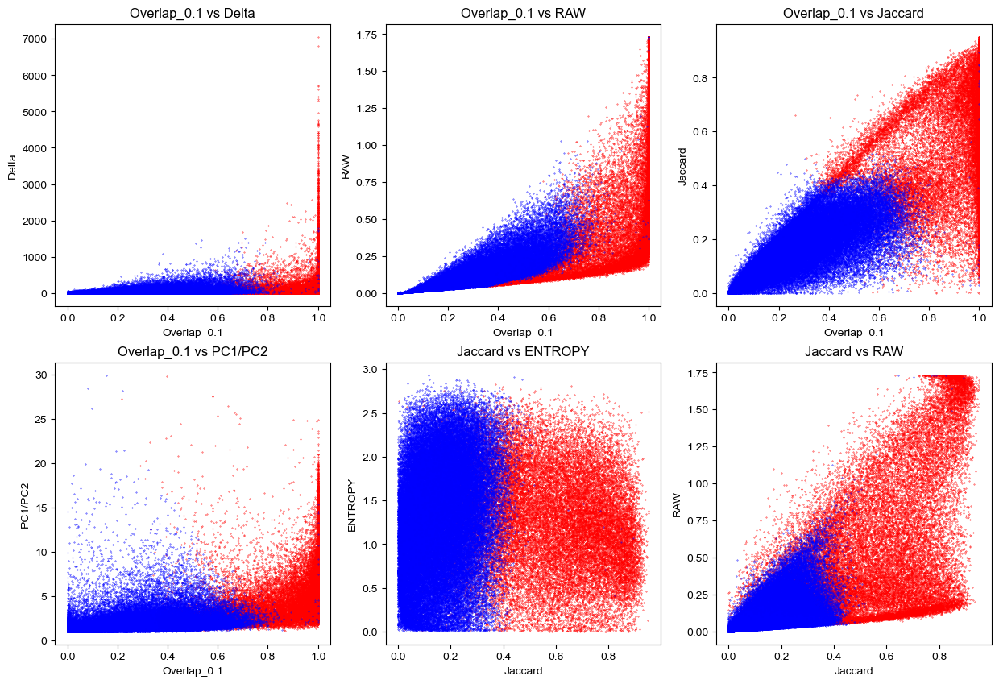

In [34]:
# plot predicted QC-passing cells
# plot partially labelled 
# scatter plot, same as above, except outlier 94.
# P vs X_NORM, RAW vs X_NORM, LOGIT vs X_NORM, ENTROPY vs X_NORM
fig, axs = plt.subplots(2,3,figsize=(15,10))
axs = axs.ravel()
col_to_plot = ['Delta','RAW','Jaccard','PC1/PC2']
# cutting off outliers
df_to_plot = soma_final[abs(soma_final.LOGIT) < 10]
df_to_plot = soma_final[soma_final['PC1/PC2']<30]
print(f"Removing {len(soma_final) - len(df_to_plot)} Cells")

col_to_plot2 = ['ENTROPY','RAW']
for i in range(len(axs)):
    if i < 4:
        col = col_to_plot[i]
        df1 = df_to_plot[df_to_plot['InfectedCells'] == 1]
        axs[i].scatter(df1['Overlap_0.1'], df1[col], s=0.1, color='r')
        df2 = df_to_plot[df_to_plot['InfectedCells'] == 0]
        axs[i].scatter(df2['Overlap_0.1'], df2[col], s=0.1, color='b')
        axs[i].set_xlabel('Overlap_0.1')
        axs[i].set_ylabel(col)
        axs[i].set_title(f'Overlap_0.1 vs {col}')
    else:
        
        df1 = df_to_plot[df_to_plot['InfectedCells'] == 1]
        axs[i].scatter(df1['Jaccard'], df1[col_to_plot2[i-4]], s=0.1, color='r')
        df2 = df_to_plot[df_to_plot['InfectedCells'] == 0]
        axs[i].scatter(df2['Jaccard'], df2[col_to_plot2[i-4]], s=0.1, color='b')
        
        #axs[i].scatter(df_to_plot['LOGIT'], df_to_plot[col_to_plot2[i-4]], s=1)
        axs[i].set_xlabel('Jaccard')
        axs[i].set_ylabel(col_to_plot2[i-4])
        axs[i].set_title(f'Jaccard vs {col_to_plot2[i-4]}')

<AxesSubplot: xlabel='embedding1', ylabel='embedding2'>

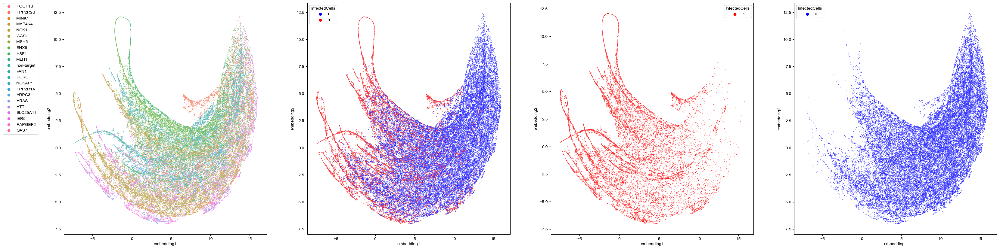

In [35]:
# plot UMAP of 5 images - embedding based on epitope signals
fig, ax = plt.subplots(1,4,figsize=(40,10))
sns.scatterplot(data = soma_final, x='embedding1', y='embedding2', hue = 'Gene', ax=ax[0], s=1)
ax[0].legend(bbox_to_anchor=(-0.3, 1), loc='upper left', borderaxespad=0)
sns.scatterplot(data = soma_final, 
                x='embedding1', y='embedding2', hue = 'InfectedCells', ax=ax[1], s=1, palette = ['blue','red'])
sns.scatterplot(data = soma_final[soma_final.InfectedCells==1],
                x='embedding1', y='embedding2', hue = 'InfectedCells', ax=ax[2], s=1, palette = ['red'])
sns.scatterplot(data = soma_final[soma_final.InfectedCells==0],
                x='embedding1', y='embedding2', hue = 'InfectedCells', ax=ax[3], s=1, palette = ['blue'])

In [36]:
# infectiviity
print("Infection Rate", round(sum(soma_final.InfectedCells)/len(soma_final),2))
print("Total Infected Cells", sum(soma_final.InfectedCells))

Infection Rate 0.3
Total Infected Cells 31184


In [37]:
# save output
soma_final.to_csv('Coverslip1_soma_final_CellPose.csv',sep=',')

## Generate Heatmap for intensity 

In [47]:
soma_final = pd.read_csv('Coverslip1_soma_final_CellPose.csv',sep=',', index_col = 0)
soma_final

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,embedding1,embedding2,True_Label,InfectedCells
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225,386.916210,PGGT1B,...,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551,12.038923,3.557579,0,0
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719,315.950102,PPP2R2B,...,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395,13.519977,8.719123,0,0
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,0.129745,460.463648,PGGT1B,...,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782,8.742785,-1.311771,0,1
5,6,intensity_mean-4,1.397341,C5,0.504649,0.361149,-0.570379,1.708385,894.584727,MINK1,...,137.174041,123.358407,661.359882,116.157817,120.578171,13.815634,1.632277,-5.368250,0,1
6,7,intensity_mean-1,0.002878,AA5,0.001691,0.587561,0.353892,0.770105,298.880108,MAP4K4,...,111.122999,110.562763,114.749789,120.347094,109.841618,0.560236,14.288588,10.225473,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111509,215,intensity_mean-13,0.036978,E4,0.029647,0.801760,1.397330,0.934359,321.817950,HRAS,...,116.650830,120.838612,148.823529,108.943439,109.590498,1.016591,16.093070,6.735689,0,0
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396,496.104350,HRAS,...,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861,11.037404,-4.996367,0,1
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,0.617955,371.703301,FAN1,...,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505,10.861491,4.165268,0,0
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479,1578.212837,WASL,...,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837,-2.793087,-3.476730,0,1


In [48]:
# compare infected vs uninfected
soma_final[['intensity_mean-0', 'intensity_mean-1',
       'intensity_mean-2', 'intensity_mean-3', 'intensity_mean-4',
       'intensity_mean-5', 'intensity_mean-6', 'Delta','InfectedCells']]

,intensity_mean-0,intensity_mean-1,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,InfectedCells
1,166.766355,175.954439,149.533879,113.026869,115.473131,152.572430,108.405374,3.038551,0
2,112.767107,116.505402,126.888355,121.707083,119.972389,113.175270,121.459784,1.487395,0
3,261.031465,232.868240,190.354966,109.291052,120.989184,112.373648,108.887906,69.365782,1
5,113.818584,526.929204,137.174041,123.358407,661.359882,116.157817,120.578171,13.815634,1
6,109.500421,109.987363,111.122999,110.562763,114.749789,120.347094,109.841618,0.560236,0
...,...,...,...,...,...,...,...,...,...
111509,108.984163,115.634238,116.650830,120.838612,148.823529,108.943439,109.590498,1.016591,0
111511,113.079306,127.956629,142.928129,156.400248,352.372986,131.462206,136.312268,6.615861,1
111512,188.278229,112.791328,108.930443,142.222222,114.551039,125.058717,150.981030,17.163505,0
111513,109.870510,706.757089,122.333648,356.823251,1333.576560,152.389414,113.064272,204.433837,1


In [49]:
# scaled intensity
from sklearn.preprocessing import StandardScaler
scaled_df = soma_final[['intensity_mean-0', 'intensity_mean-1',
       'intensity_mean-2', 'intensity_mean-3', 'intensity_mean-4',
       'intensity_mean-5', 'intensity_mean-6']].copy()

# Initialize the scaler
scaler = StandardScaler()
# Fit and transform the data
scaled_df = pd.DataFrame(scaler.fit_transform(scaled_df), columns=scaled_df.columns, index = soma_final.index)

# append back 
data_df = soma_final.copy()
data_df[['intensity_mean-0', 'intensity_mean-1',
       'intensity_mean-2', 'intensity_mean-3', 'intensity_mean-4',
       'intensity_mean-5', 'intensity_mean-6']] = scaled_df
data_df

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,intensity_mean-2,intensity_mean-3,intensity_mean-4,intensity_mean-5,intensity_mean-6,Delta,embedding1,embedding2,True_Label,InfectedCells
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225,386.916210,PGGT1B,...,-0.227106,-0.614700,-0.511803,-0.372689,-0.452708,3.038551,12.038923,3.557579,0,0
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719,315.950102,PPP2R2B,...,-0.372898,-0.527909,-0.504767,-0.428732,-0.335101,1.487395,13.519977,8.719123,0,0
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,0.129745,460.463648,PGGT1B,...,0.035701,-0.652053,-0.503177,-0.429872,-0.448361,69.365782,8.742785,-1.311771,0,1
5,6,intensity_mean-4,1.397341,C5,0.504649,0.361149,-0.570379,1.708385,894.584727,MINK1,...,-0.306678,-0.511398,0.341865,-0.424489,-0.343043,13.815634,1.632277,-5.368250,0,1
6,7,intensity_mean-1,0.002878,AA5,0.001691,0.587561,0.353892,0.770105,298.880108,MAP4K4,...,-0.474395,-0.639338,-0.512934,-0.418530,-0.439769,0.560236,14.288588,10.225473,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111509,215,intensity_mean-13,0.036978,E4,0.029647,0.801760,1.397330,0.934359,321.817950,HRAS,...,-0.438807,-0.536593,-0.459649,-0.434751,-0.442032,1.016591,16.093070,6.735689,0,0
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396,496.104350,HRAS,...,-0.269634,-0.181024,-0.141334,-0.402718,-0.201295,6.615861,11.037404,-4.996367,0,1
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,0.617955,371.703301,FAN1,...,-0.488511,-0.322785,-0.513245,-0.411827,-0.069143,17.163505,10.861491,4.165268,0,0
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479,1578.212837,WASL,...,-0.402221,1.822939,1.393090,-0.372949,-0.410736,204.433837,-2.793087,-3.476730,0,1


In [50]:
# take the mean scaled value across (or median) each genotype and then plot heatmap
# resulting size should be 22 genes by 7 procode
# infected vs uninfected
mapping = {}
tags = ['NWS','VSVG','FLAG','HSV','C','S','Ollas']
for i in range(7):
    mapping[f'intensity_mean-{i}'] = tags[i]
# rename dataframe
data_df = data_df.rename(columns = mapping)
data_df

    

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,FLAG,HSV,C,S,Ollas,Delta,embedding1,embedding2,True_Label,InfectedCells
1,2,intensity_mean-0,0.135188,A2,0.101919,0.753908,1.119566,1.035225,386.916210,PGGT1B,...,-0.227106,-0.614700,-0.511803,-0.372689,-0.452708,3.038551,12.038923,3.557579,0,0
2,3,intensity_mean-8,0.047468,D3,0.032232,0.679028,0.749309,1.367719,315.950102,PPP2R2B,...,-0.372898,-0.527909,-0.504767,-0.428732,-0.335101,1.487395,13.519977,8.719123,0,0
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,0.129745,460.463648,PGGT1B,...,0.035701,-0.652053,-0.503177,-0.429872,-0.448361,69.365782,8.742785,-1.311771,0,1
5,6,intensity_mean-4,1.397341,C5,0.504649,0.361149,-0.570379,1.708385,894.584727,MINK1,...,-0.306678,-0.511398,0.341865,-0.424489,-0.343043,13.815634,1.632277,-5.368250,0,1
6,7,intensity_mean-1,0.002878,AA5,0.001691,0.587561,0.353892,0.770105,298.880108,MAP4K4,...,-0.474395,-0.639338,-0.512934,-0.418530,-0.439769,0.560236,14.288588,10.225473,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111509,215,intensity_mean-13,0.036978,E4,0.029647,0.801760,1.397330,0.934359,321.817950,HRAS,...,-0.438807,-0.536593,-0.459649,-0.434751,-0.442032,1.016591,16.093070,6.735689,0,0
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396,496.104350,HRAS,...,-0.269634,-0.181024,-0.141334,-0.402718,-0.201295,6.615861,11.037404,-4.996367,0,1
111512,218,intensity_mean-9,0.189790,D4,0.162014,0.853646,1.763489,0.617955,371.703301,FAN1,...,-0.488511,-0.322785,-0.513245,-0.411827,-0.069143,17.163505,10.861491,4.165268,0,0
111513,219,intensity_mean-15,1.310673,E8,0.868986,0.663007,0.676725,1.312479,1578.212837,WASL,...,-0.402221,1.822939,1.393090,-0.372949,-0.410736,204.433837,-2.793087,-3.476730,0,1


In [42]:
# infected 
procode_gene_df = pd.DataFrame(index = list(set(data_df.Gene)), columns = tags)
for gene in list(set(data_df.Gene)):
    _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 1)].median(axis=0)
    procode_gene_df.loc[gene] = _df
procode_gene_df

/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/457346114.py:4: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 1)].median(axis=0)
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/457346114.py:4: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 1)].median(axis=0)
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/457346114.py:4: FutureWarning: The default value 

,NWS,VSVG,FLAG,HSV,C,S,Ollas
IER5,-0.384109,-0.367229,-0.379218,0.606714,1.134847,-0.371372,1.106602
HTT,1.065549,-0.325358,0.706102,-0.42458,-0.412339,-0.332165,0.954169
PPP2R1A,-0.375306,0.631902,-0.371782,0.249894,-0.401582,0.668708,-0.347914
MAP4K4,-0.371624,-0.377728,0.944717,-0.471211,0.394848,0.752698,-0.357492
DGKE,-0.349328,0.633317,-0.299247,-0.398684,0.634877,-0.317257,0.743698
NCKAP1,1.092849,0.986224,-0.366427,0.608098,-0.372542,-0.346206,-0.331484
PGGT1B,0.31693,0.286222,0.670094,-0.465427,-0.426815,-0.336779,-0.348672
HRAS,-0.382078,-0.374112,0.451227,0.213682,0.287348,-0.363902,-0.362778
NCK1,1.108847,1.286241,-0.360316,-0.402694,1.342379,-0.339228,-0.324644
SNX8,-0.357627,-0.358786,1.290217,0.660245,-0.381053,1.033693,-0.338076


<AxesSubplot: >

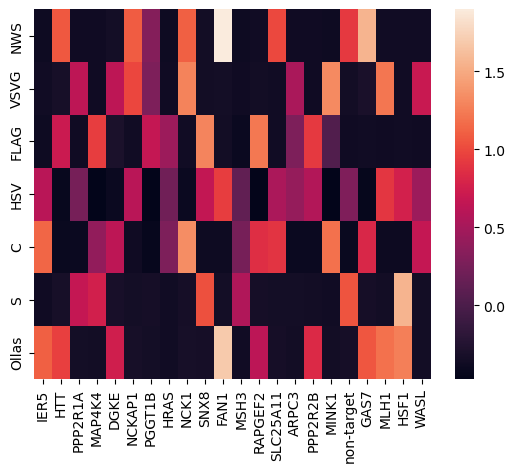

In [44]:
# heatmap
sns.heatmap(procode_gene_df.astype('float').T)

In [ ]:
# code-book concordance metric


/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/3868825542.py:4: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 0)].median(axis=0)
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/3868825542.py:4: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 0)].median(axis=0)
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_10648/3868825542.py:4: FutureWarning: The default val

<AxesSubplot: >

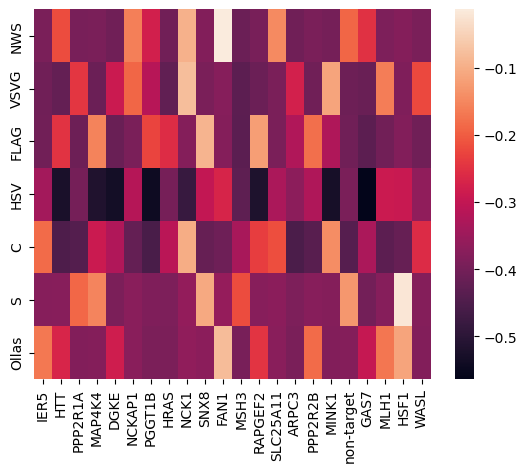

In [46]:

# infected 
procode_gene_df = pd.DataFrame(index = list(set(data_df.Gene)), columns = tags)
for gene in list(set(data_df.Gene)):
    _df = data_df[(data_df.Gene == gene)&(data_df.InfectedCells == 0)].median(axis=0)
    procode_gene_df.loc[gene] = _df
sns.heatmap(procode_gene_df.astype('float').T)


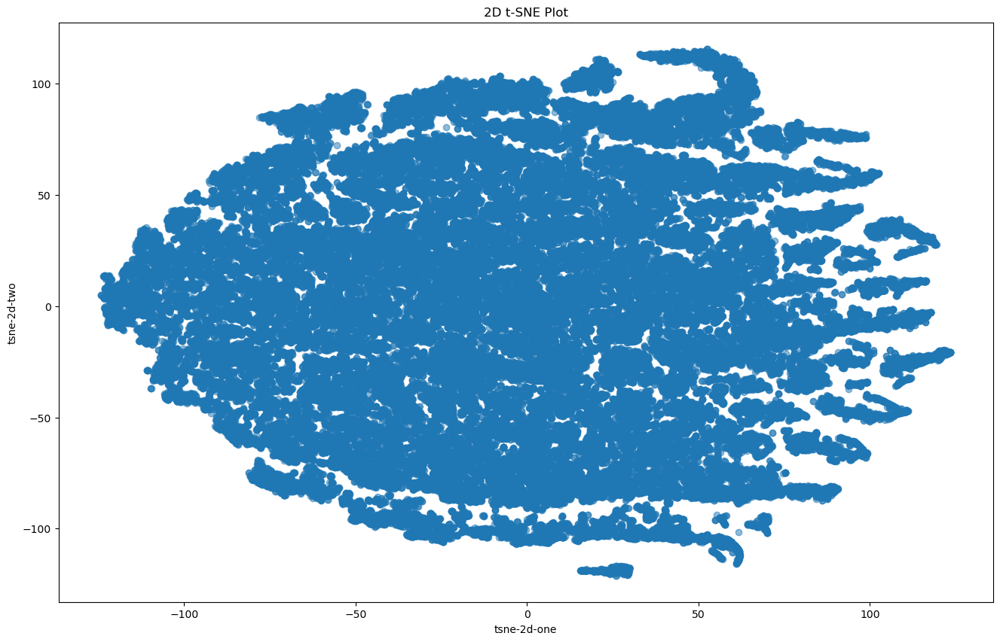

In [51]:
# all
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42)
scaled_features = data_df[tags]
tsne_results = tsne.fit_transform(scaled_features)
plt.figure(figsize=(16, 10))
plt.scatter(tsne_results[:,0], tsne_results[:,1], alpha=0.5)
plt.title('2D t-SNE Plot')
plt.xlabel('tsne-2d-one')
plt.ylabel('tsne-2d-two')
plt.show()

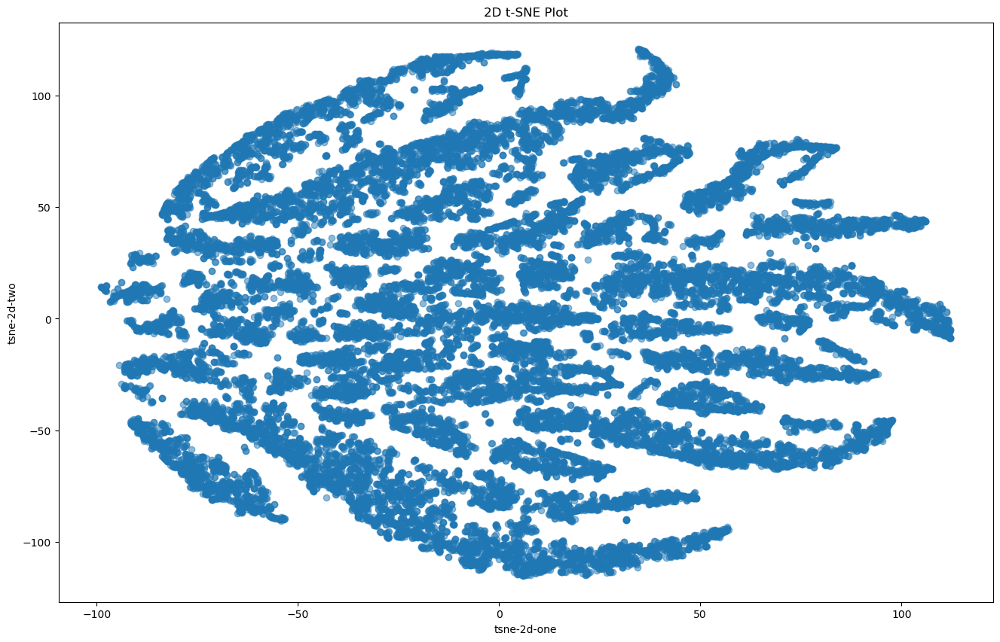

In [52]:
# infected
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42)
scaled_features = data_df[data_df.InfectedCells ==1][tags]
tsne_results = tsne.fit_transform(scaled_features)
plt.figure(figsize=(16, 10))
plt.scatter(tsne_results[:,0], tsne_results[:,1], alpha=0.5)
plt.title('2D t-SNE Plot')
plt.xlabel('tsne-2d-one')
plt.ylabel('tsne-2d-two')
plt.show()

In [57]:
tsne_df = data_df[data_df.InfectedCells==1].copy()
tsne_df['TSNE1'] = tsne_results[:, 0]
tsne_df['TSNE2'] = tsne_results[:, 1]
tsne_df

,label,Barcode_Idx,SUM,Barcode,RAW,P,LOGIT,ENTROPY,X_NORM,Gene,...,C,S,Ollas,Delta,embedding1,embedding2,True_Label,InfectedCells,TSNE1,TSNE2
3,4,intensity_mean-0,0.270628,A2,0.265434,0.980807,3.933812,0.129745,460.463648,PGGT1B,...,-0.503177,-0.429872,-0.448361,69.365782,8.742785,-1.311771,0,1,-82.703499,-0.452466
5,6,intensity_mean-4,1.397341,C5,0.504649,0.361149,-0.570379,1.708385,894.584727,MINK1,...,0.341865,-0.424489,-0.343043,13.815634,1.632277,-5.368250,0,1,-68.860596,72.274223
8,9,intensity_mean-0,1.426707,A2,1.181975,0.828463,1.574775,0.857376,1207.776634,PGGT1B,...,-0.476830,-0.277859,-0.428322,263.047094,0.375498,-0.989223,0,1,10.428075,0.972825
10,11,intensity_mean-15,0.306499,E8,0.160011,0.522061,0.088303,1.423271,430.605696,WASL,...,-0.333095,-0.408885,-0.395897,3.199798,12.841065,-2.251666,0,1,-82.249275,39.720741
14,15,intensity_mean-4,0.786941,C5,0.398723,0.506675,0.026701,1.439258,712.652966,MINK1,...,0.126221,-0.430363,-0.445646,22.120181,4.402254,-6.018330,0,1,-77.517998,62.270134
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111499,205,intensity_mean-9,0.753139,D4,0.343522,0.456121,-0.175968,1.780180,566.101977,FAN1,...,-0.239646,-0.360131,0.520875,33.915541,8.669675,-3.060530,0,1,24.144045,14.009789
111505,211,intensity_mean-9,1.605957,D4,1.116768,0.695391,0.825444,1.269275,1148.715787,FAN1,...,0.004296,-0.360649,1.923248,55.888889,0.565787,-0.810582,0,1,62.984596,11.130545
111507,213,intensity_mean-9,0.679756,D4,0.521984,0.767899,1.196487,0.948957,632.333079,FAN1,...,-0.336752,-0.431498,0.652571,32.092144,4.541426,-1.320122,0,1,38.179615,12.943760
111511,217,intensity_mean-13,0.287512,E4,0.103453,0.359820,-0.576144,1.718396,496.104350,HRAS,...,-0.141334,-0.402718,-0.201295,6.615861,11.037404,-4.996367,0,1,-85.771545,-16.858217


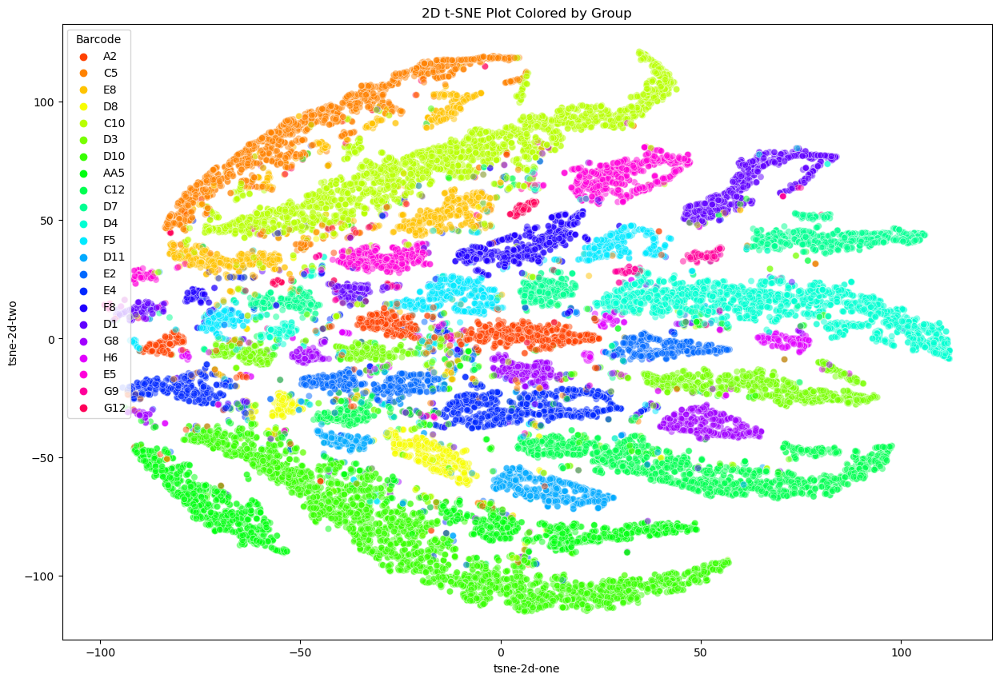

In [64]:
plt.figure(figsize=(15, 10))
sns.scatterplot(
    x='TSNE1', y='TSNE2',
    hue='Barcode',
    palette=sns.color_palette("hsv", 22),  # Adjust the palette for 22 groups
    data=tsne_df,
    legend="full",
    alpha=0.5
)
plt.title('2D t-SNE Plot Colored by Group')
plt.xlabel('tsne-2d-one')
plt.ylabel('tsne-2d-two')
plt.show()

## Run TSNE for all datasets

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path
import numpy as np
import os
import sys
import glob
import pandas as pd
import xml.etree.ElementTree as et
import datetime
from imageio import volread as imread

import tifffile

# from pystackreg import StackReg --> don't run this, run this with imlab environment
from skimage.filters import threshold_otsu

import seaborn as sns
#from pystackreg.util import to_uint16

from skimage import measure
from scipy import stats
import umap
import scanpy as sc
import math
#from umap.umap_ import UMAP
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import pickle

In [2]:
# load all dataset
adata = sc.read('../adata_integrated/adata_Cellpose_Subset_ctrlmean_all_081523.h5ad')
adata

AnnData object with n_obs × n_vars = 156636 × 2827
    obs: 'FileName_Nuclei', 'FileName_Soma', 'FileName_max', 'PathName_Nuclei', 'PathName_Soma', 'PathName_max', 'Children_Cytoplasm_Count', 'Location_CenterMassIntensity_X_AGP', 'Location_CenterMassIntensity_X_DNA', 'Location_CenterMassIntensity_X_ER', 'Location_CenterMassIntensity_X_G3BP1', 'Location_CenterMassIntensity_X_GFAP', 'Location_CenterMassIntensity_X_GM130', 'Location_CenterMassIntensity_X_Golgin97', 'Location_CenterMassIntensity_X_LAMP1', 'Location_CenterMassIntensity_X_NFKB', 'Location_CenterMassIntensity_X_NeuN', 'Location_CenterMassIntensity_X_RANGAP1', 'Location_CenterMassIntensity_X_SYTO', 'Location_CenterMassIntensity_X_TDP43', 'Location_CenterMassIntensity_X_TOM20', 'Location_CenterMassIntensity_X_fourHNE', 'Location_CenterMassIntensity_X_pRPS6', 'Location_CenterMassIntensity_Y_AGP', 'Location_CenterMassIntensity_Y_DNA', 'Location_CenterMassIntensity_Y_ER', 'Location_CenterMassIntensity_Y_G3BP1', 'Location_CenterMas

In [3]:
# check adata.obs to confirm that the metadata contains all of "soma-ProCode measurements"
for col in adata.obs.columns:
    print(col)

FileName_Nuclei
FileName_Soma
FileName_max
PathName_Nuclei
PathName_Soma
PathName_max
Children_Cytoplasm_Count
Location_CenterMassIntensity_X_AGP
Location_CenterMassIntensity_X_DNA
Location_CenterMassIntensity_X_ER
Location_CenterMassIntensity_X_G3BP1
Location_CenterMassIntensity_X_GFAP
Location_CenterMassIntensity_X_GM130
Location_CenterMassIntensity_X_Golgin97
Location_CenterMassIntensity_X_LAMP1
Location_CenterMassIntensity_X_NFKB
Location_CenterMassIntensity_X_NeuN
Location_CenterMassIntensity_X_RANGAP1
Location_CenterMassIntensity_X_SYTO
Location_CenterMassIntensity_X_TDP43
Location_CenterMassIntensity_X_TOM20
Location_CenterMassIntensity_X_fourHNE
Location_CenterMassIntensity_X_pRPS6
Location_CenterMassIntensity_Y_AGP
Location_CenterMassIntensity_Y_DNA
Location_CenterMassIntensity_Y_ER
Location_CenterMassIntensity_Y_G3BP1
Location_CenterMassIntensity_Y_GFAP
Location_CenterMassIntensity_Y_GM130
Location_CenterMassIntensity_Y_Golgin97
Location_CenterMassIntensity_Y_LAMP1
Location_C

In [4]:
adata.obs.Barcode

5_STD1_D10          C5
10_STD1_D10         E8
15_STD1_D10         D8
16_STD1_D10        C10
19_STD1_D10        D10
                  ... 
57510_-BNF2_D28     E5
57514_-BNF2_D28     D3
57518_-BNF2_D28     D4
57520_-BNF2_D28    C12
57521_-BNF2_D28    C12
Name: Barcode, Length: 156636, dtype: category
Categories (22, object): ['A2', 'AA5', 'C5', 'C10', ..., 'G8', 'G9', 'G12', 'H6']

In [5]:
# scaled intensity

raw_data = adata.obs[['intensity_mean-0', 'intensity_mean-1',
       'intensity_mean-2', 'intensity_mean-3', 'intensity_mean-4',
       'intensity_mean-5', 'intensity_mean-6']].copy()

# resulting size should be 22 genes by 7 procode
# infected vs uninfected
mapping = {}
tags = ['NWS','VSVG','FLAG','HSV','C','S','Ollas']
for i in range(7):
    mapping[f'intensity_mean-{i}'] = tags[i]
# rename dataframe
raw_data = raw_data.rename(columns = mapping)
print(raw_data.columns)

adata_procode = sc.AnnData(X = raw_data)
adata_procode.obs = adata.obs.copy()
adata_procode.layers['raw'] = adata_procode.X.copy()
print(adata_procode.shape)
# scale by each sample
for sample in set(adata_procode.obs.Sample): # Within each Sample, normalize
    print(sample)
    mu = adata_procode[(adata_procode.obs.Sample==sample)].X.mean(axis=0)
    sigma = adata_procode[(adata_procode.obs.Sample==sample)].X.std(axis=0)
    adata_procode[adata_procode.obs.Sample==sample].X = (adata_procode[adata_procode.obs.Sample==sample].X - mu)/sigma


Index(['NWS', 'VSVG', 'FLAG', 'HSV', 'C', 'S', 'Ollas'], dtype='object')
(156636, 7)
Coverslip9
Coverslip7
Coverslip13
Coverslip8
Coverslip18
Coverslip12


/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_1271/361436014.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_procode = sc.AnnData(X = raw_data)


Coverslip14
Coverslip15
Coverslip17
Coverslip16
Coverslip11
Coverslip1
Coverslip3
Coverslip2
Coverslip4


# plot heatmap - related to Figure 3C

In [6]:
# condense single-cell by epitope (156,636 by 7) into gene-by-epitope (22 by 7)
procode_gene_df = pd.DataFrame(index = list(set(adata_procode.obs.Gene)), columns = tags)
for gene in list(set(adata_procode.obs.Gene)):
    _df = adata_procode[(adata_procode.obs.Gene == gene)].X.mean(axis=0)
    procode_gene_df.loc[gene] = _df
procode_gene_df

,NWS,VSVG,FLAG,HSV,C,S,Ollas
FAN1,1.389426,-0.458589,-0.494753,0.603972,-0.509614,-0.429716,1.138243
SNX8,-0.436243,-0.466048,0.973589,0.335499,-0.509412,0.840051,-0.456905
WASL,-0.431562,0.625349,-0.510994,0.235304,0.609924,-0.438189,-0.472043
SLC25A11,0.91391,-0.478431,-0.521828,0.356972,0.753422,-0.441433,-0.468359
MINK1,-0.420495,0.889225,-0.128487,-0.642016,0.737352,-0.402918,-0.453262
HTT,0.643711,-0.481991,0.323866,-0.647023,-0.525203,-0.421461,0.521571
NCK1,0.787682,1.158327,-0.501598,-0.63081,1.167475,-0.430391,-0.464961
PPP2R1A,-0.43785,0.623651,-0.513657,0.030019,-0.51699,0.770471,-0.4662
MLH1,-0.431526,0.875142,-0.498056,0.525439,-0.508744,-0.427643,0.834649
HSF1,-0.418999,-0.459166,-0.48879,0.357201,-0.502242,1.207168,0.80835


<AxesSubplot: >

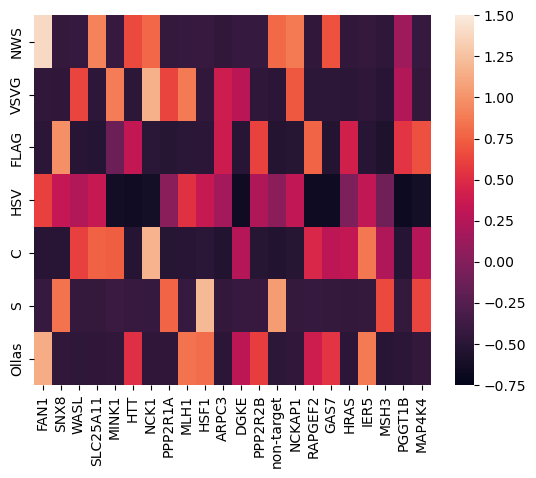

In [11]:
sns.heatmap(procode_gene_df.astype('float').T, vmin=-0.75, vmax = 1.5)

In [8]:
# side-by-side plot of codebook vs heatmap
# load codebook
META_DIR = 'metadata'
full_codebook = pd.read_csv(f'../{META_DIR}/full_codebook.csv',sep=',', index_col=0) # this is "legal" codebook
Procode_gRNA = pd.read_csv(f'../{META_DIR}/PROCODE_gRNA.csv',sep=',')
legal_codes = sorted(list(set(Procode_gRNA['ProCode ID'].to_list())))
codebook = full_codebook[legal_codes]
print(codebook.columns)
#AllProcodes = pd.read_csv('AllProcodes.csv', sep='.')



Index(['A2', 'AA5', 'C10', 'C12', 'C5', 'D1', 'D10', 'D11', 'D3', 'D4', 'D7',
       'D8', 'E2', 'E4', 'E5', 'E8', 'F5', 'F8', 'G12', 'G8', 'G9', 'H6'],
      dtype='object')


In [9]:
# construct mapping between procode ID and gene target; Procode_gRNA
pc_gene_map = {}
for pc in set(Procode_gRNA['ProCode ID']):
    pc_gene_map[pc] = Procode_gRNA[Procode_gRNA['ProCode ID'] == pc]['Gene Target'].values[0]
codebook = codebook.rename(columns = pc_gene_map)
codebook

,PGGT1B,MAP4K4,NCK1,HSF1,MINK1,IER5,SNX8,non-target,PPP2R2B,FAN1,...,PPP2R1A,HRAS,SLC25A11,WASL,ARPC3,NCKAP1,DGKE,RAPGEF2,GAS7,HTT
NWS,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0
VSVG,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0
FLAG,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0
HSV,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
C,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0
S,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Ollas,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0


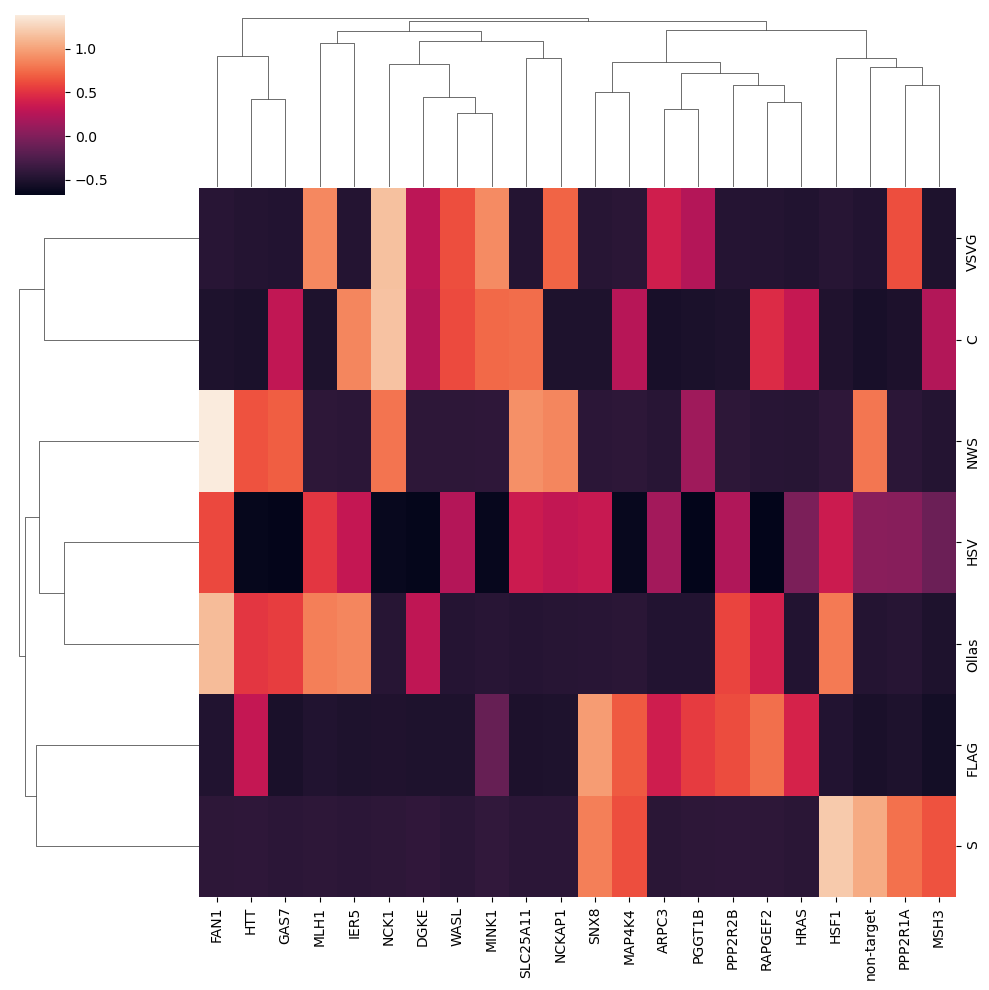

In [10]:
# save the order manually for plotting subplots;
sns.clustermap(procode_gene_df.astype('float').T)

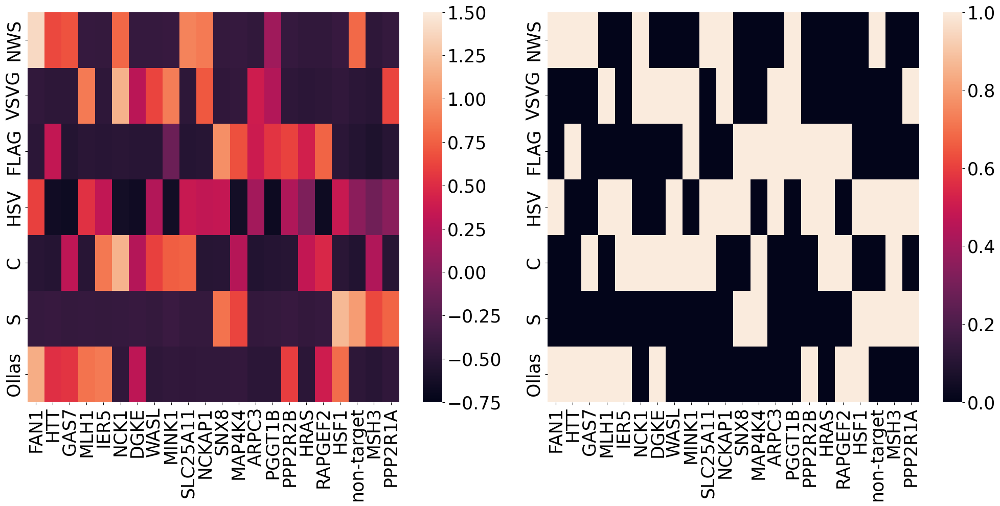

In [12]:
# order_genes
order_genes = ['FAN1','HTT','GAS7','MLH1','IER5','NCK1','DGKE','WASL','MINK1','SLC25A11','NCKAP1','SNX8',
              'MAP4K4','ARPC3','PGGT1B','PPP2R2B','HRAS','RAPGEF2','HSF1','non-target','MSH3','PPP2R1A']
fig, axs = plt.subplots(1,2, figsize = (20,10))

sns.heatmap(procode_gene_df.astype('float').T[order_genes], ax=axs[0], vmin=-.75, vmax = 1.5)
sns.heatmap(codebook[order_genes], ax=axs[1])
# Set the fontsize for row and column labels
axs[0].tick_params(axis='both', which='major', labelsize=25)
axs[1].tick_params(axis='both', which='major', labelsize=25)

cbar = axs[0].collections[0].colorbar
cbar.ax.tick_params(labelsize=25)
cbar = axs[1].collections[0].colorbar
cbar.ax.tick_params(labelsize=25)

plt.tight_layout()

plt.savefig('./Figures/all_procode_heatmap.png', format = 'png', dpi = 300)
plt.savefig('./Figures/all_procode_heatmap.eps', format = 'eps', dpi = 300)

plt.show()

In [12]:
# Visualize Clustering by using PCA, TSNE. UMAP is probably not going to work
sc.tl.pca(adata_procode, random_state=0)
#sc.pp.neighbors(adata_procode, n_pcs = 50, n_neighbors = 15)
sc.tl.tsne(adata_procode, random_state = 0)

/Users/bkang/mambaforge/envs/imlab/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


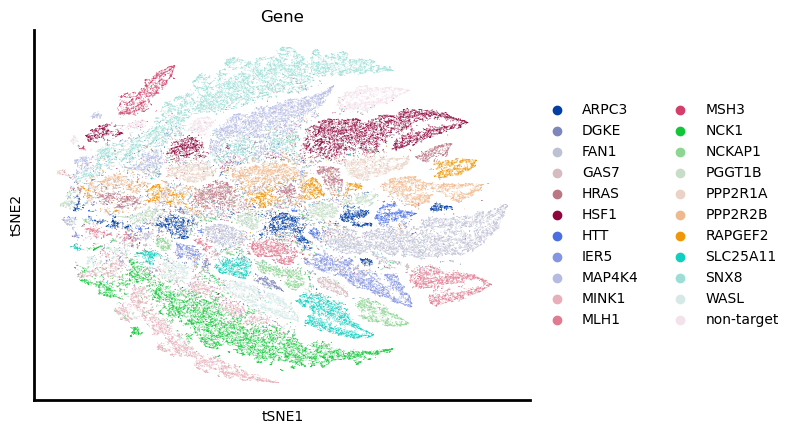

In [13]:
# visualize TSNE
sc.pl.tsne(adata_procode, color='Gene', show=False)

# Customize the plot
fig, ax = plt.gca().get_figure(), plt.gca()

# Set transparent background
fig.patch.set_alpha(0)
ax.patch.set_alpha(0)

# Customize axis lines
ax.spines['left'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Customize dot size
for artist in ax.get_children():
    if isinstance(artist, plt.Line2D):
        artist.set_markersize(5)  # Change the size as needed

# Save the figure
fig.savefig('./Figures/tsne_plot.png', dpi=300, bbox_inches='tight', transparent=True)
plt.show()

/Users/bkang/mambaforge/envs/imlab/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


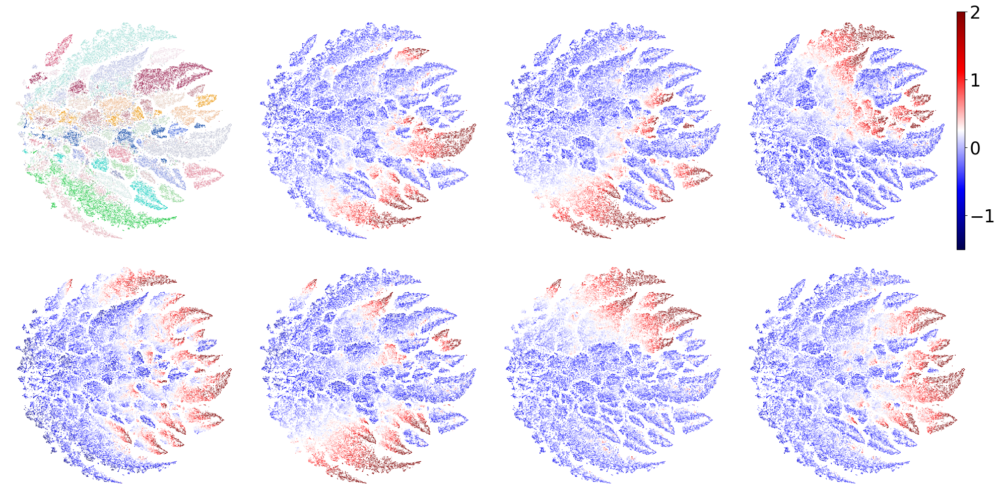

In [54]:
# plot epitopes
epi_list = list(adata_procode.var.index)

fig, axs = plt.subplots(2,4, figsize = (20,10))
axs = axs.ravel()
for i in range(8):
    if i == 0:
        sc.pl.tsne(adata_procode, color='Gene', show=False, frameon=False, legend_loc = None, ax=axs[i])
    #elif (i == 3) | (i == 7):
    elif i==3:
        sc.pl.tsne(adata_procode, color=epi_list[i-1], show=False, frameon=False, 
                   legend_loc = None, colorbar_loc = 'right', use_raw= False, ax=axs[i], vmin=-1.5, vmax=2, 
                  cmap = 'seismic')
        cbar = axs[i].collections[0].colorbar
        cbar.ax.tick_params(labelsize=25)
    else:
        sc.pl.tsne(adata_procode, color=epi_list[i-1], show=False, frameon=False, 
                   legend_loc = None, colorbar_loc = None, use_raw= False, ax=axs[i], vmin=-1.5, vmax=2, 
                  cmap = 'seismic')
    axs[i].set_title('')
plt.tight_layout(pad=1.0)

fig.savefig('./Figures/tsne_plot_subplots_just_colorbar.png',
            format = 'png', dpi=300, bbox_inches='tight', transparent=True)
fig.savefig('./Figures/tsne_plot_subplots_just_colorbar.eps', dpi=300, format = 'eps',
            bbox_inches='tight', transparent=True)

plt.show()

/Users/bkang/mambaforge/envs/imlab/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


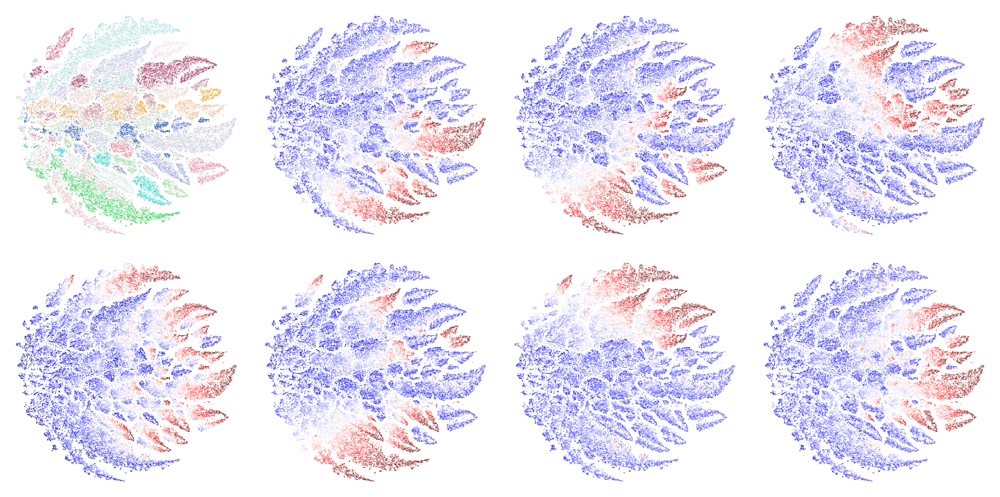

In [55]:
# plot epitopes
epi_list = list(adata_procode.var.index)

fig, axs = plt.subplots(2,4, figsize = (20,10))
axs = axs.ravel()
for i in range(8):
    if i == 0:
        sc.pl.tsne(adata_procode, color='Gene', show=False, frameon=False, legend_loc = None, ax=axs[i])
    
    else:
        sc.pl.tsne(adata_procode, color=epi_list[i-1], show=False, frameon=False, 
                   legend_loc = None, colorbar_loc = None, use_raw= False, ax=axs[i], vmin=-1.5, vmax=2, 
                  cmap = 'seismic')
    axs[i].set_title('')
plt.tight_layout(pad=1.0)

fig.savefig('./Figures/tsne_plot_subplots.png', format = 'png',dpi=300, bbox_inches='tight', transparent=True)
fig.savefig('./Figures/tsne_plot_subplots.eps', format = 'eps', dpi=300, bbox_inches='tight', transparent=True)

plt.show()

In [22]:
# check ranges
for i in range(8):
    print(adata_procode[:, adata_procode.var_names.isin([epi_list[i-1]])].X.min(), 
          adata_procode[:, adata_procode.var_names.isin([epi_list[i-1]])].X.max(),
         np.quantile(adata_procode[:, adata_procode.var_names.isin([epi_list[i-1]])].X, 0.25),
         np.quantile(adata_procode[:, adata_procode.var_names.isin([epi_list[i-1]])].X, 0.95))

-1.069692 26.536617 -0.5450720191001892 1.927092283964157
-1.0365474 17.835253 -0.5451905280351639 1.9549498558044434
-1.0625533 15.202768 -0.5727729052305222 1.9398883283138275
-1.1104115 34.22034 -0.585354819893837 1.8625748455524445
-1.739387 48.49296 -0.6340266168117523 1.842957466840744
-1.1813934 13.247197 -0.6034456342458725 1.9689498245716095
-0.9111625 19.405094 -0.5240899473428726 1.9063952565193176
-1.069692 26.536617 -0.5450720191001892 1.927092283964157


## Plot single-cells for demonstarting ProCode true positive vs false positives

In [30]:
os.getcwd()

'/Volumes/imagestore/Brian/Kang_et_al_2024_Codes'

In [47]:
# use coverslip 1 data (this one has human-labelled ground truth labels)
DATA_DIR = '101222_D10_Coverslip1_Processed'
SEG_DIR = 'Cellpose_Segmentation_masks'
MP_DIR = 'mp_score_max'
CP_DIR = 'cp_output_cellpose'
META_DIR = 'metadata'

seg_df = pd.read_csv(f'../{DATA_DIR}/{CP_DIR}/CP_Cellpose_Soma_filtered_32.csv', index_col=0)
soma_df = pd.read_csv(f'../{DATA_DIR}/Coverslip1_soma_df_CellPose.csv')

def get_cell_coords_center(cell_label, coord_data):
    
    x2 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMaximum_X']
    y2 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMaximum_Y']
    x1 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMinimum_X']
    y1 = coord_data.loc[cell_label, 'AreaShape_BoundingBoxMinimum_Y']
    
    return round(x1+(x2-x1)/2), round(y1+(y2-y1)/2)


In [48]:
print_flag = False
interval = 50

image_num = 13 # 63 113 163 213
epi_cols = [f'intensity_mean-{k}' for k in range(7)] # to define scores_df
coord_data = seg_df[seg_df.ImageNumber == image_num].set_index('ObjectNumber')
barcoded = soma_df[soma_df.ImageNumber == image_num].set_index('label')
fov = coord_data.FileName_max.values[0].split('F')[-1][:3] # 004

soma = imread(f'../{DATA_DIR}/{SEG_DIR}/F{fov}_max_Soma.tiff')
mpscore = imread(f'../{DATA_DIR}/{MP_DIR}/F{fov}_mp_score_max.tif').transpose(1,2,0) # YXC
seg = imread(f'../{DATA_DIR}/max/F{fov}_max.tif')      
scores = measure.regionprops_table(soma, mpscore, properties = ['label','intensity_mean'])
scores_df = pd.DataFrame(scores)
scores_df = scores_df.set_index('label')


In [49]:
import math
image_sets = range(math.ceil(len(labels)/interval))

for image_set in image_sets: # 0,1,2,3
    labels_subsets=labels[image_set*interval:(image_set+1)*interval]
    print(labels_subsets)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]
[51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100]
[101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150]
[151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200]
[201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221

In [50]:
image_set = 0
labels_subsets = labels[image_set*interval:(image_set+1)*interval]
labels_subsets

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50]

In [61]:
image_sets[0]

0

/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_64665/3677241640.py:34: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axs[i][0].imshow(im_to_show[y-24:y+24, x-24:x+24], cmap = 'gray') # plot cell
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_64665/3677241640.py:39: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axs[i][1].imshow(mpscore[y-24:y+24, x-24:x+24, top_idx], cmap = 'gray')
/var/folders/s7/fg8686z944s5332vtll29z5h0000gn/T/ipykernel_64665/3677241640.py:48: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  axs[i][j].imshow(seg[j-1][y-24:y+24, x-24:x+24],


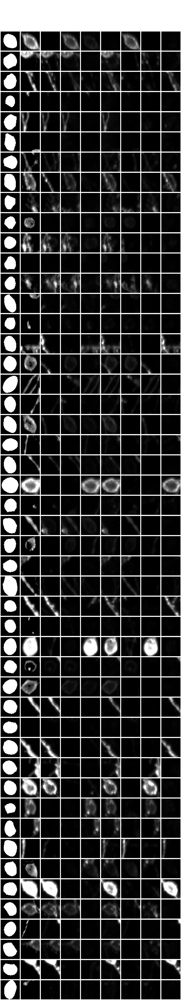

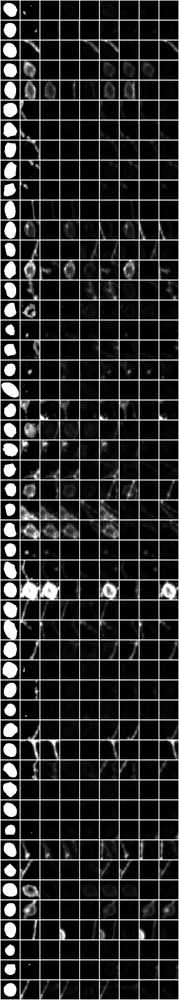

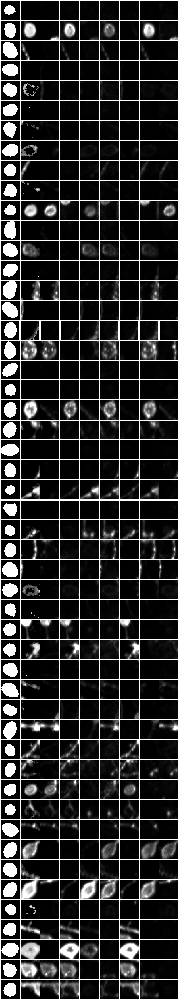

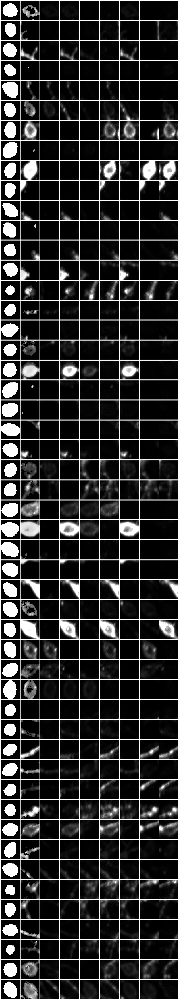

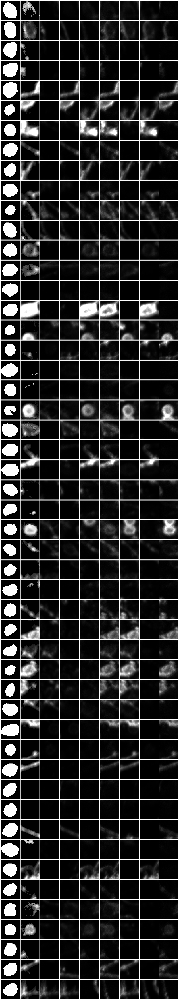

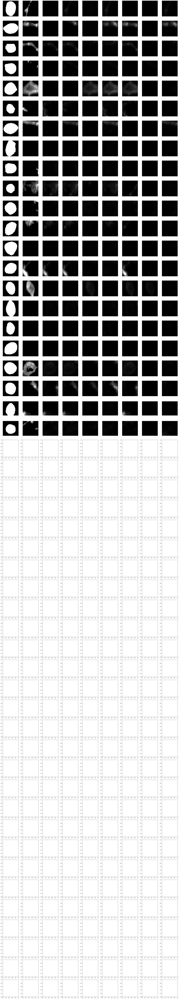

In [63]:
# example
print_flag = False
interval = 50

image_num = 13 # 63 113 163 213
epi_cols = [f'intensity_mean-{k}' for k in range(7)] # to define scores_df
coord_data = seg_df[seg_df.ImageNumber == image_num].set_index('ObjectNumber')
barcoded = soma_df[soma_df.ImageNumber == image_num].set_index('label')
fov = coord_data.FileName_max.values[0].split('F')[-1][:3] # 004

soma = imread(f'../{DATA_DIR}/{SEG_DIR}/F{fov}_max_Soma.tiff')
mpscore = imread(f'../{DATA_DIR}/{MP_DIR}/F{fov}_mp_score_max.tif').transpose(1,2,0) # YXC
seg = imread(f'../{DATA_DIR}/max/F{fov}_max.tif')      
scores = measure.regionprops_table(soma, mpscore, properties = ['label','intensity_mean'])
scores_df = pd.DataFrame(scores)
scores_df = scores_df.set_index('label')

labels = barcoded.index.tolist() # cell numbers 1,2,3,...280
    
import math
image_sets = range(math.ceil(len(labels)/interval))

for image_set in image_sets: # 0,1,2,3
    labels_subsets=labels[image_set*interval:(image_set+1)*interval]
    if print_flag:
        print(labels_subsets)
    # plot intervals
    fig, axs = plt.subplots(interval,9, figsize = (27,3*interval))
    for i in range(len(labels_subsets)):
        label = labels_subsets[i]
        #cell_id = coord_data[coord_data['ObjectNumber']==label].index[0]
        x,y = get_cell_coords_center(label,coord_data) # get center of cell coordinates.
        im_to_show = soma == label
        axs[i][0].imshow(im_to_show[y-24:y+24, x-24:x+24], cmap = 'gray') # plot cell 
        #axs[i][0].set_title(barcoded.loc[label, 'Barcode']+ "...Label " + str(label))
        axs[i][0].axis('off')
            # top 2 barcodes and 7 channels
        top_idx = np.argsort(scores_df.loc[label].values)[-1]
        axs[i][1].imshow(mpscore[y-24:y+24, x-24:x+24, top_idx], cmap = 'gray')
        axs[i][1].axis('off')
        #top_2_idx = np.argsort(scores_df.loc[label].values)[-1] # increasing orders
        #for j in range(1,3): # 1 2 
        #    idx = top_2_idx[j-1] # 0 1
        #    axs[i][j].imshow(mpscore[y-24:y+24, x-24:x+24, idx], cmap = 'gray') 
        #    #axs[i][j].set_title(codebook.columns.tolist()[idx])
        #    axs[i][j].axis('off')
        for j in range(2,9): # 2, 3, 4, 5, 6, 7, 8
            axs[i][j].imshow(seg[j-1][y-24:y+24, x-24:x+24], 
                             vmin = np.quantile(seg[j-1],0.05), vmax = np.quantile(seg[j-1], 0.999),
                            cmap = 'gray')
            #axs[i][j].set_title(codebook.index.tolist()[j-3])
            axs[i][j].axis('off')
    plt.tight_layout()    
    plt.savefig(f'./Figures/procode_single_cell_crop_exampes_{image_set}.png',format = 'png',dpi = 300)
    plt.savefig(f'./Figures/procode_single_cell_crop_exampes_{image_set}.eps',format = 'eps',dpi = 300)
    
    